# ROI Visualization

SpatialTis provides four ROI visualization methods:

- Cell Map
- Expression Map
- Neighbors Map
- Community Map

In this example I use MIBI dataset from this article:

[A Structured Tumor-Immune Microenvironment in Triple Negative Breast Cancer Revealed by Multiplexed Ion Beam Imaging](https://doi.org/10.1016/j.cell.2018.08.039). To [Download](https://uofmacau-my.sharepoint.com/:u:/g/personal/yb97643_umac_mo/ET7-chqWIc9EqSEtY-foQ7IBURusGw9hlTSBC3xD_bNdgw?download=1)

For origin data, follow their instruction in the article to request it. The processed data is placed at their [lab's page](https://www.angelolab.com/mibi-data). The data contains 41 patients, one ROI per patient.


In [1]:
import warnings
warnings.filterwarnings("ignore", category=FutureWarning)

In [2]:
import anndata as ad
import spatialtis as st
import spatialtis.plotting as sp
from spatialtis import CONFIG

data = ad.read_h5ad("../data/MIBI_data.h5ad")
data = data[data.obs['area'] < 1000].copy()
data

AnnData object with n_obs × n_vars = 181376 × 39
    obs: 'Patient', 'area', 'cell_shape', 'centroid', 'eccentricity', 'cell_type'
    var: 'markers'

In [3]:
CONFIG.EXP_OBS = ['Patient']
CONFIG.CELL_TYPE_KEY = "cell_type"
CONFIG.MARKER_KEY = "markers"

## Cell Map

This is used to show the distribution of different type of cells in a ROI. If your cells has morphology information, the cell can be display in polygon.

You can easily see that most of the cells in the ROI are tumor cells.

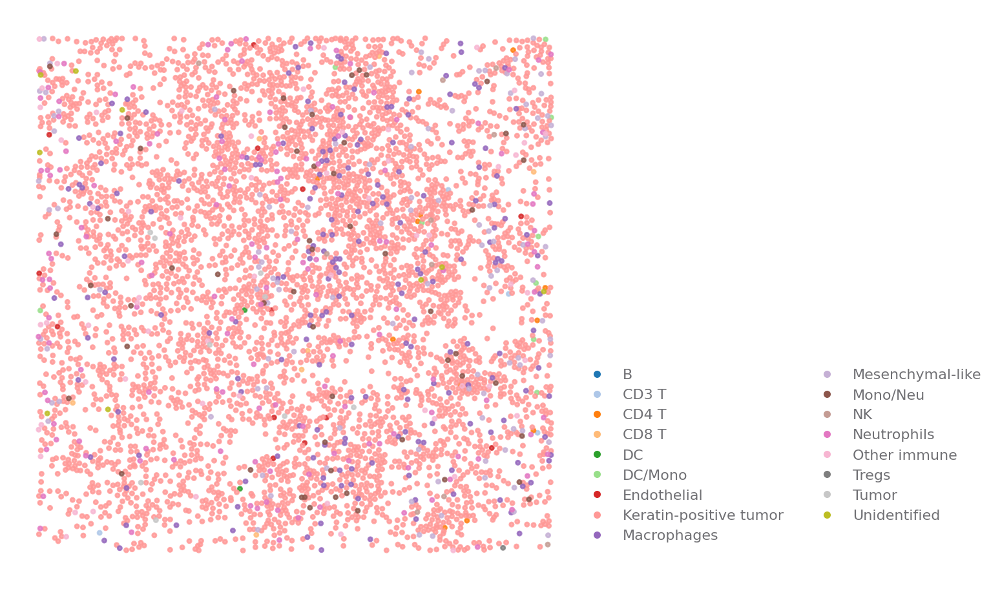

In [4]:
ROI = {"Patient": "Patient 21"}
sp.cell_map(data, ROI)

For interactive plotting, you can click on the legend to mute the specific cell type

In [5]:
sp.cell_map(data, ROI, use="interactive", size=(500, 700))

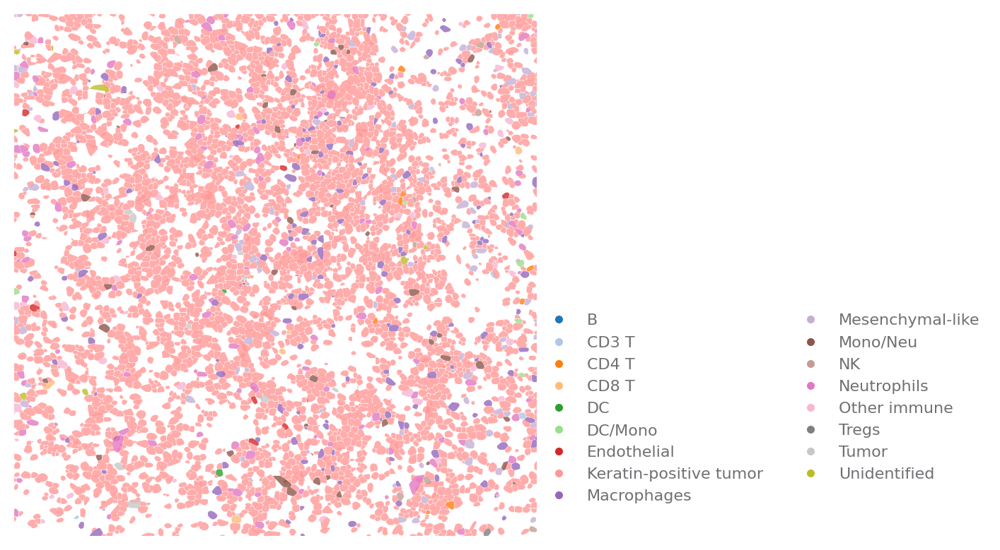

In [6]:
sp.cell_map(data, ROI, use_shape=True)

In [7]:
sp.cell_map(data, ROI, use_shape=True, use="interactive", size=(500, 700))

## Expression Map

To show marker expression in a ROI.

Here, let's check how "CD45" expressed.

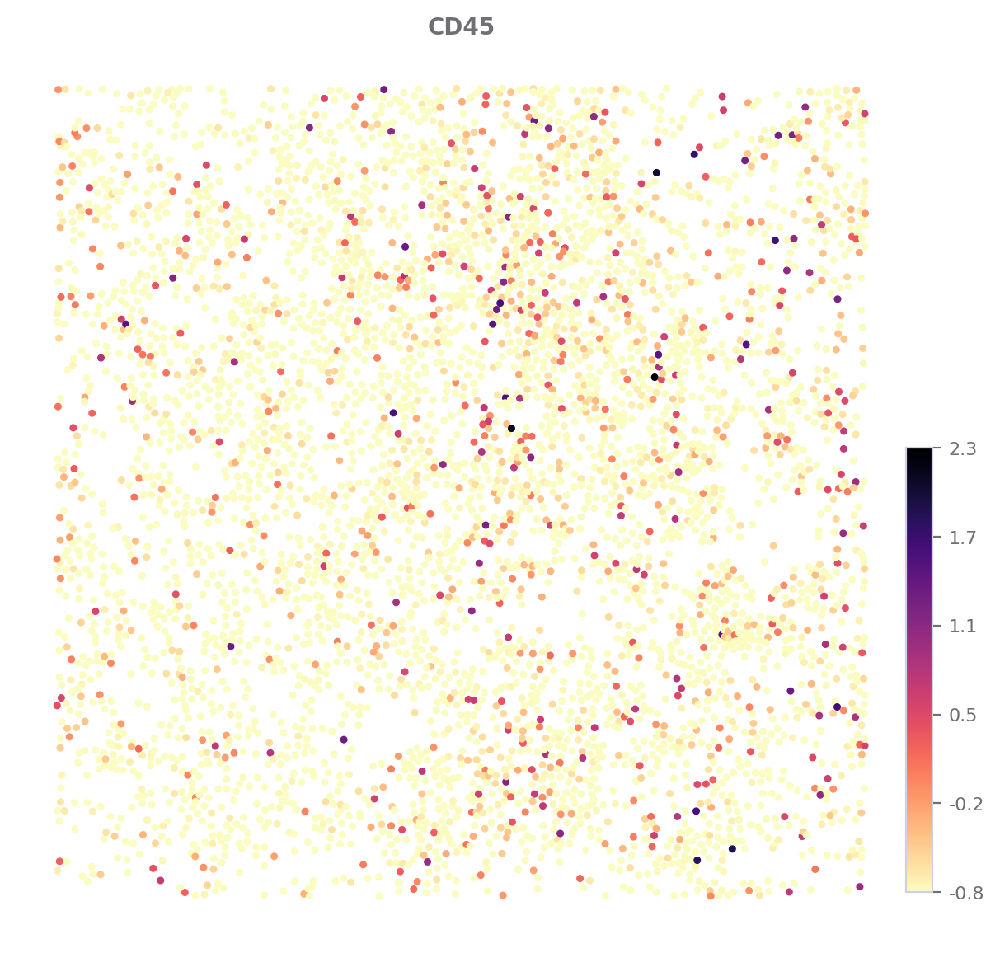

In [8]:
sp.expression_map(data, ROI, "CD45", title="CD45", size=(7, 7))

For pyecharts' visualization, you need to call `.render()`. You can also use this to rerender any visualization.

In [9]:
sp.expression_map(data, ROI, "CD45", use="interactive").render()

## Neighbors Map

To show the neighbor relationship of cells.

You need to run the `find_neighbors` analysis to show the result.

In [10]:
st.find_neighbors(data, use_shape=True, expand=5)

Get cell bbox ██████████ 100% 00:00|00:08
Find neighbors ██████████ 100% 00:00|00:00


Rendering large ROI using matplotlib will take a long time. The pyecharts is rendering using WebGL, which is much faster.

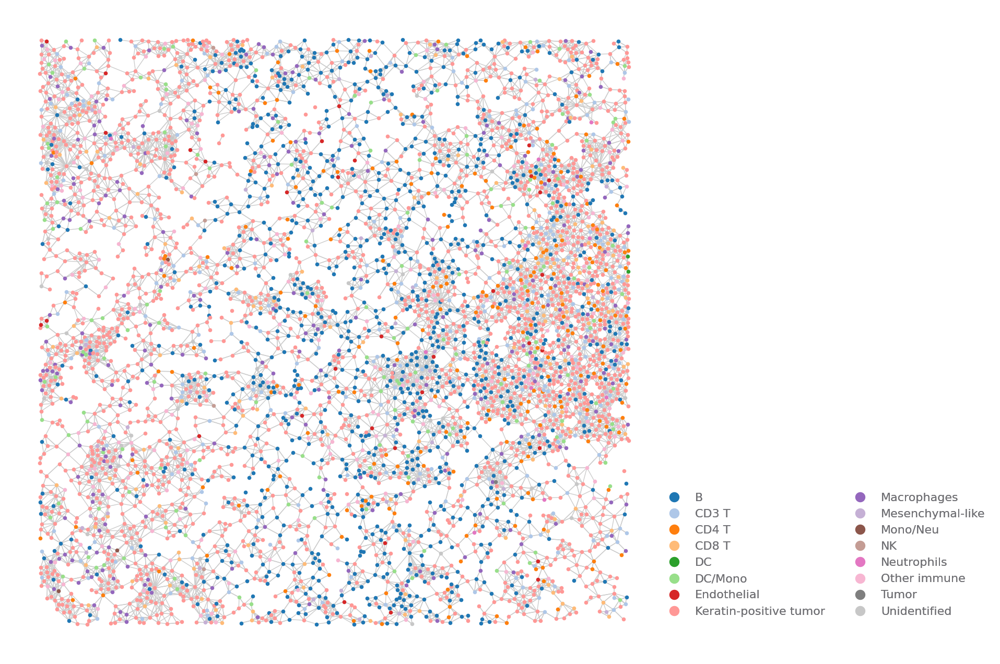

In [11]:
ROI = {"Patient": "Patient 1"}
sp.neighbors_map(data, ROI, size=(8, 8))

In [12]:
sp.neighbors_map(data, ROI, use="interactive", size=(800, 800)).render()

## Community map

To show spatial communities in ROI.

You need to run `cell_community` analysis to show the result.

In [13]:
st.cell_community(data)

Communities detection ██████████ 100% 00:00|00:00


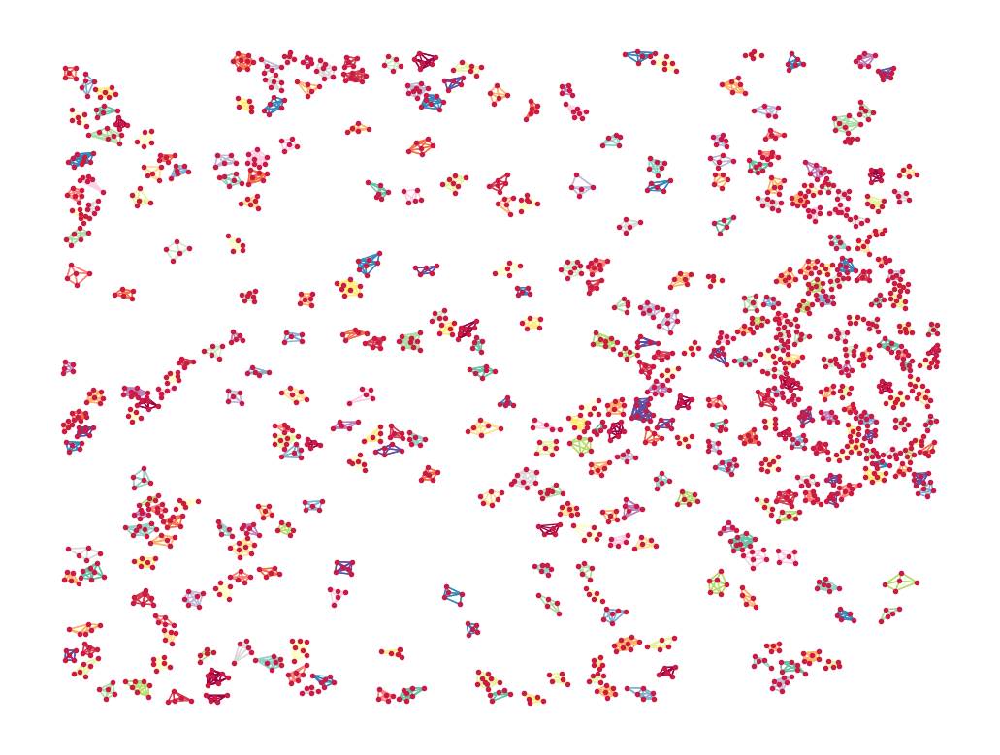

In [14]:
sp.community_map(data, ROI, min_cells=5)

In [15]:
sp.community_map(data, {"Patient": "Patient 1"}, use="interactive").render()